In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
import math
import os
import yfinance as yf
import pandas_datareader as pdr
import datetime as dt
import tensorflow as tf
from tensorflow.keras import layers
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder, StandardScaler
from sklearn.metrics import davies_bouldin_score, mean_absolute_error, mean_squared_error
from dtaidistance import dtw
import kmedoids

In [20]:
yf.pdr_override()
sp500 = yf.download('SPY', start='2016-01-04', end='2022-10-29')
sp500['return'] = np.log(sp500.Close/sp500.Close.shift(1))
sp500['cumreturn'] = sp500['return'].cumsum().apply(np.exp)
sp500.fillna(1, inplace=True)
sp500

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume,return,cumreturn
Date,,,,,,,,
2016-01-04,200.490005,201.029999,198.589996,201.020004,177.237350,222353500,1.000000,1.000000
2016-01-05,201.399994,201.899994,200.050003,201.360001,177.537155,110845800,0.001690,1.001691
2016-01-06,198.339996,200.059998,197.600006,198.820007,175.297684,152112600,-0.012694,0.989056
2016-01-07,195.330002,197.440002,193.589996,194.050003,171.092026,213436100,-0.024284,0.965327
2016-01-08,195.190002,195.850006,191.580002,191.919998,169.214066,209817200,-0.011037,0.954731
...,...,...,...,...,...,...,...,...
2022-10-24,375.890015,380.059998,373.109985,378.869995,377.138184,85436900,0.012162,1.884738
2022-10-25,378.790009,385.250000,378.670013,384.920013,383.160522,78846300,0.015842,1.914834
2022-10-26,381.619995,387.579987,381.350006,382.019989,380.273773,104087300,-0.007563,1.900408


In [21]:
df = pd.read_csv(f"{os.path.dirname(os.getcwd())}\SP500 stock OHLC extended.csv", header=0, index_col=0, parse_dates=[0])
data = df.copy()
data = data.loc[data.index > '2004-08-11', ['Open', 'Close', 'symbol', 'industry']]
data

,Open,Close,symbol,industry
Date,,,,
2004-08-12,15.579399,14.077253,A,Health Care
2004-08-13,15.293276,14.678112,A,Health Care
2004-08-16,14.556509,14.821173,A,Health Care
2004-08-17,14.964235,15.157368,A,Health Care
2004-08-18,15.193133,15.572246,A,Health Care
...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials
2022-10-25,47.720001,51.509998,ZION,Financials
2022-10-26,51.040001,50.400002,ZION,Financials


In [22]:
lag = 100
indicators = ['Close_norm']
for i in range(1, lag):
    indicators.append(f'Close_norm_{i}')

In [38]:
train_dic = {}
test_dic = {}
period = 30

for ticker in data.symbol.unique():
    temp = data.loc[data.symbol == ticker, :]
    temp.loc[:, 'Close_norm'] = temp['Close']
    temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
    for i in range(1, lag):
        temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
    tempT = temp.loc[:, indicators].transpose()
    normalizer = MinMaxScaler(feature_range=(0,1))
    normT = normalizer.fit_transform(tempT)
    temp.loc[:, indicators] = normT.transpose()
    
    train = temp.loc[(temp.index >= '2011-01-01') & (temp.index < '2016-01-01')]
    test = temp.loc[(temp.index >= '2016-01-01') & (temp.index <= '2022-10-28')]
    
    dfs = [train, test]
    dics = [train_dic, test_dic]
    
    for i in range(len(dfs)):
        df, dic = dfs[i], dics[i]
        df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
        df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
        df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
        dic[ticker] = df

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_i

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many ti

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from 

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target_direction'] = np.where(df.Target > 0, 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,c

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'Close_norm'] = temp['Close']
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'return'] = np.log(temp.Close/temp.Close.shift(1))
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_index

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, f'Close_norm_{i}'] = temp.Close.shift(i)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_in

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Close_shifted'] = df.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.loc[:, 'Target'] = ((df['Close_shifted']-df['Open'])/df['Open']).shift(-1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataF

C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\anaconda3\lib\site-packages\sklearn\utils\validation.py:1688: FutureWarning: Feature names only support names that are all strings. Got feature names with dtypes: ['Timestamp']. An error will be raised in 1.2.
  warnings.warn(
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, indicators] = normT.transpose()
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3129786786.py:24: SettingWithCopyWarning: 
A value is trying to be

In [39]:
train_df = pd.concat(train_dic.values())
train_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,Target_direction
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,29.728184,29.957083,A,Health Care,0.997324,0.010803,0.967224,0.977926,0.984615,0.972575,...,0.106355,0.105017,0.165217,0.154515,0.012709,0.025418,0.037458,32.038628,0.015718,1
2011-01-04,30.035765,29.678112,A,Health Care,0.971237,-0.009356,0.997324,0.967224,0.977926,0.984615,...,0.066221,0.106355,0.105017,0.165217,0.154515,0.012709,0.025418,30.507868,0.055986,1
2011-01-05,29.513592,29.613733,A,Health Care,0.965217,-0.002172,0.971237,0.997324,0.967224,0.977926,...,0.026087,0.066221,0.106355,0.105017,0.165217,0.154515,0.012709,31.165951,0.061639,1
2011-01-06,29.592276,29.670959,A,Health Care,0.970569,0.001931,0.965217,0.971237,0.997324,0.967224,...,0.048161,0.026087,0.066221,0.106355,0.105017,0.165217,0.154515,31.416309,0.057803,1
2011-01-07,29.699572,29.771103,A,Health Care,0.979933,0.003369,0.970569,0.965217,0.971237,0.997324,...,0.036120,0.048161,0.026087,0.066221,0.106355,0.105017,0.165217,31.416309,0.026081,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-24,27.629999,27.780001,ZION,Financials,0.252000,0.003968,0.230000,0.128000,0.050000,0.038000,...,0.720000,0.692000,0.824000,1.000000,0.840000,0.898000,0.944000,NaN,NaN,0
2015-12-28,27.629999,27.639999,ZION,Financials,0.224000,-0.005052,0.252000,0.230000,0.128000,0.050000,...,0.796000,0.720000,0.692000,0.824000,1.000000,0.840000,0.898000,NaN,NaN,0
2015-12-29,27.879999,27.809999,ZION,Financials,0.258000,0.006132,0.224000,0.252000,0.230000,0.128000,...,0.772000,0.796000,0.720000,0.692000,0.824000,1.000000,0.840000,NaN,NaN,0


In [25]:
with open('train_dic.pkl', 'wb') as f:
    pickle.dump(train_dic, f)

with open('test_dic.pkl', 'wb') as f:
    pickle.dump(test_dic, f)

In [10]:
# with open('train_dic.pkl', 'rb') as f:
#     train_dic = pickle.load(f)

# with open('val_dic.pkl', 'rb') as f:
#     val_dic = pickle.load(f)

# with open('test_dic.pkl', 'rb') as f:
#     test_dic = pickle.load(f)

In [26]:
returns = train_df.copy()
returns.loc[:, 'Date'] = returns.index
returns = returns.pivot(index='Date', columns='symbol', values='return')
returns

symbol,A,AAP,AAPL,ABC,ABMD,ABT,ACGL,ACN,ADBE,ADI,...,WTW,WY,WYNN,XEL,XOM,XRAY,YUM,ZBH,ZBRA,ZION
Date,,,,,,,,,,,,,,,,,,,,,
2011-01-03,0.010803,-0.009875,0.021500,0.005845,0.019578,-0.001880,0.004985,0.002060,0.016433,0.007406,...,0.015189,0.042912,0.048405,0.000425,0.019368,0.026853,0.000815,0.023747,0.005513,0.038061
2011-01-04,-0.009356,-0.051052,0.005205,-0.011134,0.000000,0.009366,-0.006235,-0.006607,0.007006,-0.011395,...,-0.016923,-0.010684,0.030719,0.004236,0.004684,-0.011173,-0.015396,-0.013369,-0.009469,-0.016423
2011-01-05,-0.002172,0.001284,0.008147,0.015205,0.023198,0.000000,0.001477,0.000207,0.022282,0.002130,...,0.013789,0.030725,0.012819,-0.005935,-0.002674,0.009462,0.004747,0.000737,-0.001058,0.005638
2011-01-06,0.001931,-0.033448,-0.000809,0.011541,0.001992,-0.002074,-0.013604,0.003721,0.001551,0.005570,...,0.002849,-0.006969,0.007265,-0.000851,0.006405,-0.005724,0.006976,-0.031440,-0.008502,-0.002815
2011-01-07,0.003369,0.026363,0.007136,0.002006,-0.016048,0.004143,-0.007626,0.001650,-0.007153,-0.005836,...,-0.001708,0.027102,0.034794,0.008896,0.005439,-0.004026,0.012395,-0.000190,0.003197,-0.010526
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-12-24,0.008819,0.000470,-0.005355,0.000096,0.023296,0.000000,0.002412,-0.001821,-0.004233,0.005650,...,0.003416,0.003260,0.003186,-0.003073,-0.010782,-0.002132,-0.001620,0.001361,-0.002114,0.003968
2015-12-28,-0.008580,0.009477,-0.011264,0.002306,-0.015170,-0.001553,0.005371,-0.001440,-0.001061,-0.006181,...,0.002767,-0.004895,-0.012072,0.011130,-0.007465,0.004913,-0.002165,-0.006434,-0.011067,-0.005052
2015-12-29,0.013787,0.010900,0.017815,0.005551,0.042471,0.017392,0.004220,0.011843,0.011924,0.015120,...,0.044480,0.001308,0.025713,0.002211,0.005320,0.011371,0.005403,0.005073,0.002565,0.006132


In [27]:
returnsT = returns.transpose().fillna(0)
returnsT

Date,2011-01-03,2011-01-04,2011-01-05,2011-01-06,2011-01-07,2011-01-10,2011-01-11,2011-01-12,2011-01-13,2011-01-14,...,2015-12-17,2015-12-18,2015-12-21,2015-12-22,2015-12-23,2015-12-24,2015-12-28,2015-12-29,2015-12-30,2015-12-31
symbol,,,,,,,,,,,,,,,,,,,,,
A,0.010803,-0.009356,-0.002172,0.001931,0.003369,0.014313,0.016910,0.004415,-0.003717,0.006726,...,-0.015814,-0.016815,0.018041,0.009506,0.013255,0.008819,-0.008580,0.013787,-0.004496,-0.008573
AAP,-0.009875,-0.051052,0.001284,-0.033448,0.026363,0.007406,-0.005953,0.013305,0.003021,0.003012,...,-0.049390,-0.023131,0.000535,-0.012236,0.008286,0.000470,0.009477,0.010900,-0.005270,-0.005896
AAPL,0.021500,0.005205,0.008147,-0.000809,0.007136,0.018657,-0.002368,0.008104,0.003652,0.008067,...,-0.021424,-0.027442,0.012186,-0.000932,0.012787,-0.005355,-0.011264,0.017815,-0.013145,-0.019382
ABC,0.005845,-0.011134,0.015205,0.011541,0.002006,-0.005742,0.009742,-0.006006,0.014807,0.001412,...,0.007355,-0.004505,0.009865,0.002621,0.007533,0.000096,0.002306,0.005551,0.002383,-0.012552
ABMD,0.019578,0.000000,0.023198,0.001992,-0.016048,0.013059,0.006962,0.014757,0.004871,-0.005848,...,-0.010104,0.022278,0.008186,-0.007273,0.006480,0.023296,-0.015170,0.042471,-0.007678,-0.020176
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
XRAY,0.026853,-0.011173,0.009462,-0.005724,-0.004026,0.010321,0.007388,0.026817,0.000551,-0.000275,...,-0.003148,-0.010510,0.007019,0.008787,0.007565,-0.002132,0.004913,0.011371,-0.008109,-0.009161
YUM,0.000815,-0.015396,0.004747,0.006976,0.012395,0.001413,-0.006474,-0.002439,-0.005100,-0.021915,...,-0.018389,-0.004999,0.021482,-0.005465,0.015226,-0.001620,-0.002165,0.005403,-0.005809,-0.010350
ZBH,0.023747,-0.013369,0.000737,-0.031440,-0.000190,0.007766,0.035039,0.014649,-0.004679,0.005935,...,-0.012041,-0.017529,0.012752,0.014855,0.010171,0.001361,-0.006434,0.005073,-0.002923,0.001170


In [28]:
dtw_mat = dtw.distance_matrix_fast(returnsT.to_numpy(), parallel=True)
dtw_mat

DTAIDistance C-extension for Numpy is not available. Proceeding anyway.


array([[0.        , 0.54697371, 0.47626401, ..., 0.4397631 , 0.53279631,
        0.43318627],
       [0.54697371, 0.        , 0.47256833, ..., 0.4641299 , 0.50651283,
        0.53195625],
       [0.47626401, 0.47256833, 0.        , ..., 0.40076627, 0.51581135,
        0.47650343],
       ...,
       [0.4397631 , 0.4641299 , 0.40076627, ..., 0.        , 0.49358024,
        0.44545306],
       [0.53279631, 0.50651283, 0.51581135, ..., 0.49358024, 0.        ,
        0.52844487],
       [0.43318627, 0.53195625, 0.47650343, ..., 0.44545306, 0.52844487,
        0.        ]])

In [29]:
with open('dtw_mat.pkl', 'wb') as f:
    pickle.dump(dtw_mat, f)

,Difference in SS
2,NaN
3,-1.850300
4,-1.336574
5,-1.118554
6,-0.978569
7,-0.963719
8,-0.899996
9,-0.874674
10,-0.838261
11,-0.776831


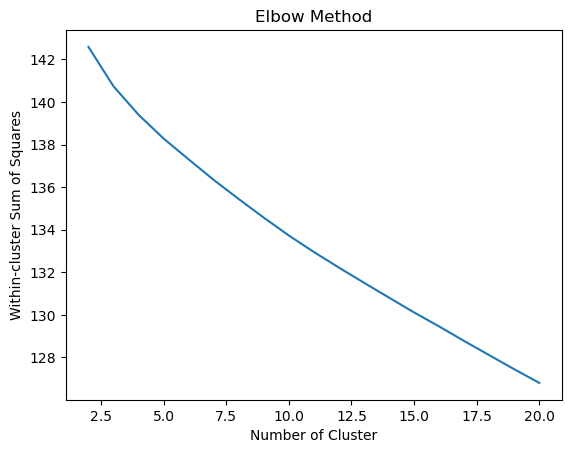

In [30]:
kmax = 20
ssq_list = []
for k in range(2, kmax+1):
    ssq = kmedoids.KMedoids(n_clusters=k,
                           random_state=0).fit(dtw_mat).inertia_
    ssq_list.append(ssq)
    
plt.plot(range(2, kmax+1), ssq_list)
plt.title("Elbow Method") 
plt.xlabel("Number of Cluster") 
plt.ylabel("Within-cluster Sum of Squares")

pd.DataFrame(ssq_list, columns = ['Difference in SS'], index = range(2,kmax+1)).diff()

,score
2,1.245050
3,1.238945
4,1.726250
5,3.065826
6,2.841103
7,2.544849
8,2.267724
9,2.242253
10,2.062156
11,1.916682


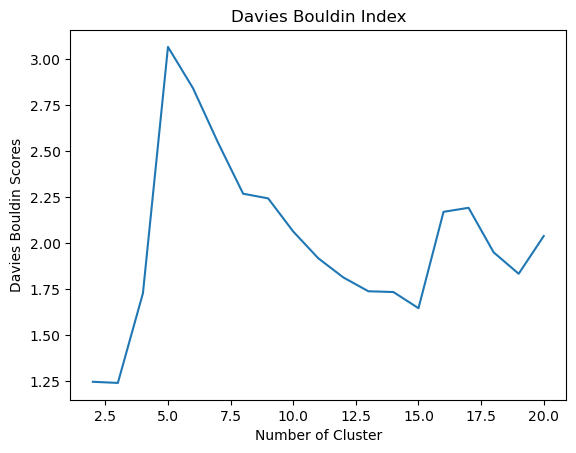

In [31]:
# Davies Bouldin score
db_scores = []
for k in range(2, kmax+1):
    score = kmedoids.KMedoids(n_clusters=k,
                              random_state=0).fit(dtw_mat).labels_
    db_scores.append(davies_bouldin_score(dtw_mat, score))
    
plt.plot(range(2, kmax+1), db_scores)
plt.title("Davies Bouldin Index") 
plt.xlabel("Number of Cluster") 
plt.ylabel("Davies Bouldin Scores")

pd.DataFrame(db_scores, columns=['score'], index=range(2,kmax+1))

In [33]:
# Get 3 clusters
num_clusters = 3
clusters_pred = kmedoids.KMedoids(n_clusters=num_clusters,
                                 random_state=0).fit_predict(dtw_mat)
clusters_pred_df = pd.DataFrame({'symbol': returns.columns,
                                 'cluster': clusters_pred})
clusters_pred_df

,symbol,cluster
0,A,1
1,AAP,1
2,AAPL,1
3,ABC,2
4,ABMD,0
...,...,...
388,XRAY,1
389,YUM,2
390,ZBH,1
391,ZBRA,1


In [34]:
clusters_pred_df.to_csv('clusters.csv')

In [45]:
# Prepare dataset for feeding into NN model

def get_dataset(cluster, df, train_val_data=True):
    symbols = clusters_pred_df.loc[clusters_pred_df['cluster']==cluster, 'symbol']
    temp = df.loc[df.symbol.isin(symbols), :]
    if train_val_data:
        temp = temp.loc[~temp.index.isin(temp.index.unique()[-period:]), :]
    x, y = temp.loc[:, indicators].to_numpy(), temp.loc[:, 'Target_direction'].to_numpy()
    x_reshaped = np.array([np.transpose(row.reshape(1, 100)) for row in x])
    return x_reshaped, y

In [46]:
def create_early_stopping():
    return tf.keras.callbacks.EarlyStopping(monitor='loss',
                                           patience=3)

In [47]:
def plot_history(histories):
    fig, ax = plt.subplots(num_clusters, 2, figsize=(150,150))
    plt.tight_layout()
    metrics = ['accuracy', 'loss']
    for i in range(num_clusters):
        history = histories[i]
        for j in range(2):
            metric = metrics[j]
            ax[i,j].plot(history.history[f'{metric}'])
            ax[i,j].legend([f'{metric}'], loc='upper left')
            ax[i,j].set_title(f'cluster_{i}')
            ax[i,j].figure.set_size_inches(30,30)

In [48]:
# Train LSTM models for each cluster

histories = []
for i in range(num_clusters):
    train_x, train_y = get_dataset(i, train_df)
    
    tf.random.set_seed(0)
    inputs = layers.Input(shape=(100,1), dtype=tf.float32)
    x = layers.LSTM(128, activation='tanh', input_shape=(1,100,1))(inputs)
    x = layers.Dropout(0.2)(x)
    output = layers.Dense(1, activation='sigmoid')(x)
    
    model = tf.keras.Model(inputs, output)
    model.compile(loss='binary_crossentropy',
                 optimizer='Adam',
                 metrics=['accuracy'])
    
    history = model.fit(train_x,
                        train_y,
                        epochs=5,
                        callbacks = [create_early_stopping()])
    
    histories.append(history)
    file_loc = f'{os.getcwd()}\cluster_{i}_model'
    tf.keras.models.save_model(model, file_loc)

Epoch 1/5
1881/1881 [==============================] - 227s 119ms/step - loss: 0.6846 - accuracy: 0.5649
Epoch 2/5
1881/1881 [==============================] - 203s 108ms/step - loss: 0.6859 - accuracy: 0.5634
Epoch 3/5
1881/1881 [==============================] - 194s 103ms/step - loss: 0.6852 - accuracy: 0.5654
Epoch 4/5
1881/1881 [==============================] - 219s 116ms/step - loss: 0.6852 - accuracy: 0.5646


INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_0_model\assets


INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_0_model\assets


Epoch 1/5
7791/7791 [==============================] - 869s 111ms/step - loss: 0.6751 - accuracy: 0.5958
Epoch 2/5
7791/7791 [==============================] - 417s 53ms/step - loss: 0.6748 - accuracy: 0.5958
Epoch 3/5
7791/7791 [==============================] - 354s 45ms/step - loss: 0.6747 - accuracy: 0.5958
Epoch 4/5
7791/7791 [==============================] - 787s 101ms/step - loss: 0.6746 - accuracy: 0.5958
Epoch 5/5
7791/7791 [==============================] - 867s 111ms/step - loss: 0.6740 - accuracy: 0.5958


INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_1_model\assets


INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_1_model\assets


Epoch 1/5
5411/5411 [==============================] - 624s 115ms/step - loss: 0.6661 - accuracy: 0.6111
Epoch 2/5
5411/5411 [==============================] - 531s 98ms/step - loss: 0.6658 - accuracy: 0.6112
Epoch 3/5
5411/5411 [==============================] - 292s 54ms/step - loss: 0.6655 - accuracy: 0.6111
Epoch 4/5
5411/5411 [==============================] - 264s 49ms/step - loss: 0.6642 - accuracy: 0.6111
Epoch 5/5
5411/5411 [==============================] - 272s 50ms/step - loss: 0.6629 - accuracy: 0.6112


INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_2_model\assets


INFO:tensorflow:Assets written to: C:\Users\kmlee\Desktop\Quant-Projects\SP500\DTW_KMedoids_LSTM_strategy\cluster_2_model\assets


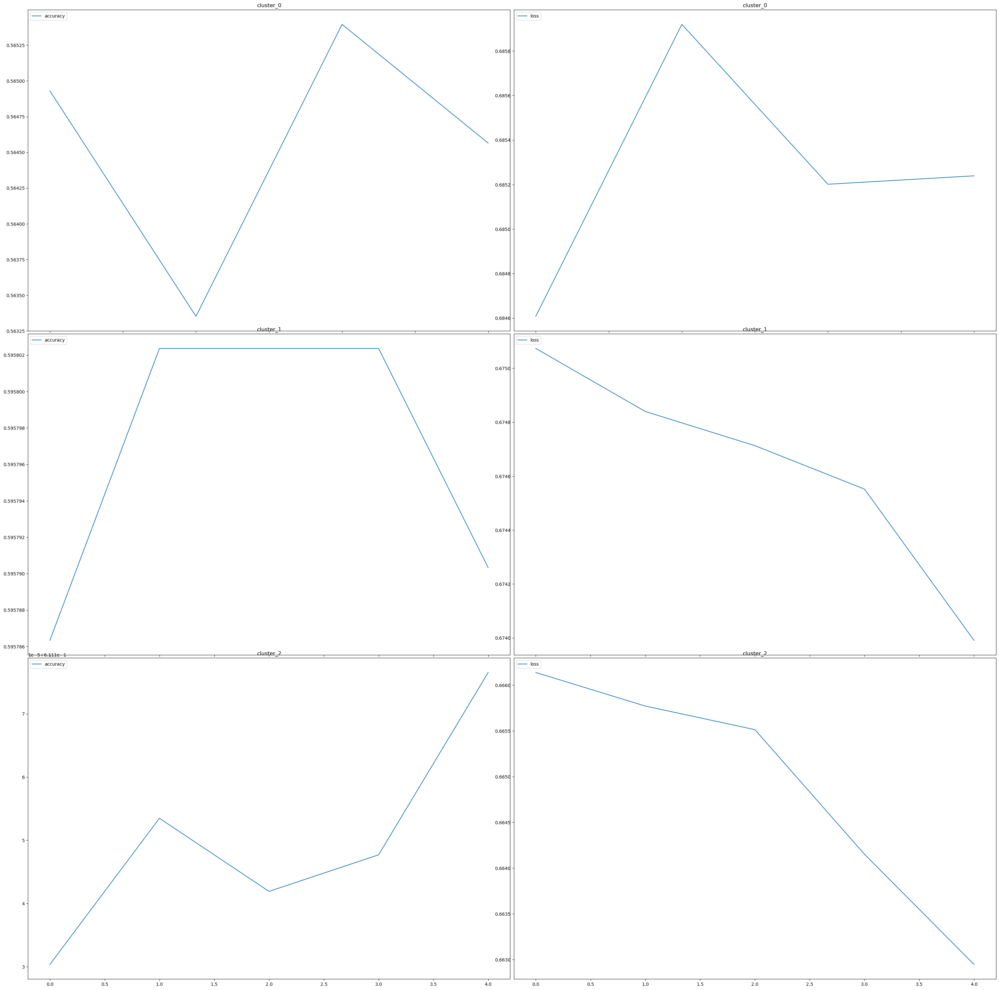

In [49]:
plot_history(histories)

In [50]:
test_df = pd.concat(test_dic.values())
test_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_93,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,Target_direction
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.814238,-0.027153,0.938821,0.978865,1.000000,0.935484,...,0.460512,0.559511,0.628476,0.606229,0.587319,0.577308,0.614016,37.080002,-0.070219,0
2016-01-05,40.730000,40.549999,A,Health Care,0.798665,-0.003447,0.814238,0.938821,0.978865,1.000000,...,0.318131,0.460512,0.559511,0.628476,0.606229,0.587319,0.577308,37.869999,-0.075795,0
2016-01-06,40.240002,40.730000,A,Health Care,0.818687,0.004429,0.798665,0.814238,0.938821,0.978865,...,0.145718,0.318131,0.460512,0.559511,0.628476,0.606229,0.587319,37.189999,-0.067265,0
2016-01-07,40.139999,39.000000,A,Health Care,0.626251,-0.043403,0.818687,0.798665,0.814238,0.938821,...,0.110123,0.145718,0.318131,0.460512,0.559511,0.628476,0.606229,37.439999,-0.030342,0
2016-01-08,39.220001,38.590000,A,Health Care,0.580645,-0.010568,0.626251,0.818687,0.798665,0.814238,...,0.250278,0.110123,0.145718,0.318131,0.460512,0.559511,0.628476,38.029999,-0.039783,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,0.223440,0.040169,0.058179,0.000000,0.176223,0.408937,...,0.477234,0.644182,0.792580,0.865093,0.822934,0.793423,0.840641,NaN,NaN,0
2022-10-25,47.720001,51.509998,ZION,Financials,0.369308,0.034163,0.223440,0.058179,0.000000,0.176223,...,0.333895,0.477234,0.644182,0.792580,0.865093,0.822934,0.793423,NaN,NaN,0
2022-10-26,51.040001,50.400002,ZION,Financials,0.275717,-0.021785,0.369308,0.223440,0.058179,0.000000,...,0.395447,0.333895,0.477234,0.644182,0.792580,0.865093,0.822934,NaN,NaN,0


In [51]:
preds = []

for i in range(num_clusters):
    symbols = clusters_pred_df.loc[clusters_pred_df.cluster==i, 'symbol']
    tf.keras.backend.clear_session()
    model = tf.keras.models.load_model(f'{os.getcwd()}\cluster_{i}_model')
    temp = test_df.loc[test_df.symbol.isin(symbols), :]
    testx = temp.loc[:, indicators].to_numpy()
    temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]
    preds.append(temp)

2633/2633 [==============================] - 64s 24ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3362511603.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


10905/10905 [==============================] - 198s 18ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3362511603.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


7575/7575 [==============================] - 167s 22ms/step


C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\3362511603.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'prediction'] = model.predict(testx)[:, 0]


In [52]:
preds_df = pd.concat(preds)
preds_df = preds_df.sort_values(['symbol', 'Date'])
preds_df

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_94,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,Target_direction,prediction
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.814238,-0.027153,0.938821,0.978865,1.000000,0.935484,...,0.559511,0.628476,0.606229,0.587319,0.577308,0.614016,37.080002,-0.070219,0,0.620195
2016-01-05,40.730000,40.549999,A,Health Care,0.798665,-0.003447,0.814238,0.938821,0.978865,1.000000,...,0.460512,0.559511,0.628476,0.606229,0.587319,0.577308,37.869999,-0.075795,0,0.621154
2016-01-06,40.240002,40.730000,A,Health Care,0.818687,0.004429,0.798665,0.814238,0.938821,0.978865,...,0.318131,0.460512,0.559511,0.628476,0.606229,0.587319,37.189999,-0.067265,0,0.621367
2016-01-07,40.139999,39.000000,A,Health Care,0.626251,-0.043403,0.818687,0.798665,0.814238,0.938821,...,0.145718,0.318131,0.460512,0.559511,0.628476,0.606229,37.439999,-0.030342,0,0.621241
2016-01-08,39.220001,38.590000,A,Health Care,0.580645,-0.010568,0.626251,0.818687,0.798665,0.814238,...,0.110123,0.145718,0.318131,0.460512,0.559511,0.628476,38.029999,-0.039783,0,0.620548
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,0.223440,0.040169,0.058179,0.000000,0.176223,0.408937,...,0.644182,0.792580,0.865093,0.822934,0.793423,0.840641,NaN,NaN,0,0.586772
2022-10-25,47.720001,51.509998,ZION,Financials,0.369308,0.034163,0.223440,0.058179,0.000000,0.176223,...,0.477234,0.644182,0.792580,0.865093,0.822934,0.793423,NaN,NaN,0,0.587553
2022-10-26,51.040001,50.400002,ZION,Financials,0.275717,-0.021785,0.369308,0.223440,0.058179,0.000000,...,0.333895,0.477234,0.644182,0.792580,0.865093,0.822934,NaN,NaN,0,0.587925


In [53]:
port_size = 20

for i in range(len(test_df.index.unique())):
    date = list(test_df.index.unique())[i]
    temp = preds_df.loc[preds_df.index==date, :]
    top_df = temp.sort_values(['prediction'], ascending=False).head(port_size)
    if i%period == 0:
        temp.loc[:, 'position'] = np.where(temp.symbol.isin(top_df['symbol']), 1, 0)
    else:
        temp.loc[:, 'position'] = [0]*len(temp)
    temp = temp.sort_values(['symbol'])
    preds_df.loc[preds_df.index == date, 'position'] = temp.loc[:, 'position']
    
preds_df

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\34920265.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'position'] = np.where(temp.symbol.isin(top_df['symbol']), 1, 0)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\34920265.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  temp.loc[:, 'position'] = [0]*len(temp)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\34920265.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row

,Open,Close,symbol,industry,Close_norm,return,Close_norm_1,Close_norm_2,Close_norm_3,Close_norm_4,...,Close_norm_95,Close_norm_96,Close_norm_97,Close_norm_98,Close_norm_99,Close_shifted,Target,Target_direction,prediction,position
Date,,,,,,,,,,,,,,,,,,,,,
2016-01-04,41.060001,40.689999,A,Health Care,0.814238,-0.027153,0.938821,0.978865,1.000000,0.935484,...,0.628476,0.606229,0.587319,0.577308,0.614016,37.080002,-0.070219,0,0.620195,0.0
2016-01-05,40.730000,40.549999,A,Health Care,0.798665,-0.003447,0.814238,0.938821,0.978865,1.000000,...,0.559511,0.628476,0.606229,0.587319,0.577308,37.869999,-0.075795,0,0.621154,0.0
2016-01-06,40.240002,40.730000,A,Health Care,0.818687,0.004429,0.798665,0.814238,0.938821,0.978865,...,0.460512,0.559511,0.628476,0.606229,0.587319,37.189999,-0.067265,0,0.621367,0.0
2016-01-07,40.139999,39.000000,A,Health Care,0.626251,-0.043403,0.818687,0.798665,0.814238,0.938821,...,0.318131,0.460512,0.559511,0.628476,0.606229,37.439999,-0.030342,0,0.621241,0.0
2016-01-08,39.220001,38.590000,A,Health Care,0.580645,-0.010568,0.626251,0.818687,0.798665,0.814238,...,0.145718,0.318131,0.460512,0.559511,0.628476,38.029999,-0.039783,0,0.620548,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-10-24,48.320000,49.779999,ZION,Financials,0.223440,0.040169,0.058179,0.000000,0.176223,0.408937,...,0.792580,0.865093,0.822934,0.793423,0.840641,NaN,NaN,0,0.586772,0.0
2022-10-25,47.720001,51.509998,ZION,Financials,0.369308,0.034163,0.223440,0.058179,0.000000,0.176223,...,0.644182,0.792580,0.865093,0.822934,0.793423,NaN,NaN,0,0.587553,0.0
2022-10-26,51.040001,50.400002,ZION,Financials,0.275717,-0.021785,0.369308,0.223440,0.058179,0.000000,...,0.477234,0.644182,0.792580,0.865093,0.822934,NaN,NaN,0,0.587925,0.0


In [55]:
preds_df.to_csv('preds.csv')

In [56]:
def get_pnl(x):
    if x['position'].sum() > 0:
        return ((x['Target'])*x['position']).sum()/port_size + 1
    return 1

In [62]:
def strategy_return(preds_df):
    strategies = pd.DataFrame()
    strategies['avg return'] = preds_df.groupby('Date').apply(get_pnl).shift(period).fillna(1)
    strategies['strategy'] = np.log(strategies['avg return'])
    strategies['cumstrategy'] = strategies['strategy'].cumsum().apply(np.exp)
    return strategies

In [63]:
test_preds = strategy_return(preds_df)
test_preds

,avg return,strategy,cumstrategy
Date,,,
2016-01-04,1.0,0.0,1.000000
2016-01-05,1.0,0.0,1.000000
2016-01-06,1.0,0.0,1.000000
2016-01-07,1.0,0.0,1.000000
2016-01-08,1.0,0.0,1.000000
...,...,...,...
2022-10-24,1.0,0.0,2.083819
2022-10-25,1.0,0.0,2.083819
2022-10-26,1.0,0.0,2.083819


In [71]:
test_preds.loc[test_preds.index < '2021-01-01', :]

,avg return,strategy,cumstrategy
Date,,,
2016-01-04,1.0,0.0,1.000000
2016-01-05,1.0,0.0,1.000000
2016-01-06,1.0,0.0,1.000000
2016-01-07,1.0,0.0,1.000000
2016-01-08,1.0,0.0,1.000000
...,...,...,...
2020-12-24,1.0,0.0,1.982999
2020-12-28,1.0,0.0,1.982999
2020-12-29,1.0,0.0,1.982999


In [73]:
hits = np.where((preds_df.loc[preds_df.index < '2021-01-01']['Target_direction'] == preds_df.loc[preds_df.index < '2021-01-01']['position']) & 
                (preds_df.loc[preds_df.index < '2021-01-01']['position'] == 1) &
                (preds_df.loc[preds_df.index < '2021-01-01']['Target'].isnull() == False), 1, 0)
np.sum(hits)/len(preds_df.loc[preds_df.index < '2021-01-01'][(preds_df.loc[preds_df.index < '2021-01-01'].Target.isnull()==False)&(preds_df.loc[preds_df.index < '2021-01-01'].position==1)])*100

57.49999999999999

In [74]:
hits = np.where((preds_df['Target_direction'] == preds_df['position']) & 
                (preds_df['position'] == 1) &
                (preds_df['Target'].isnull() == False), 1, 0)
np.sum(hits)/len(preds_df[(preds_df.Target.isnull()==False)&(preds_df.position==1)])*100

56.05263157894736

In [59]:
def plot_returns(benchmark, strategy, title):
    plt.figure(figsize=(20, 12))
    plt.plot(pd.to_datetime(strategy.index).date, strategy.cumstrategy, label='Model')
    plt.plot(benchmark.index, benchmark['cumreturn'], color='red', label='SP500 Buy & Hold')
    plt.title(title)
    plt.gca().grid(True)
    plt.legend()

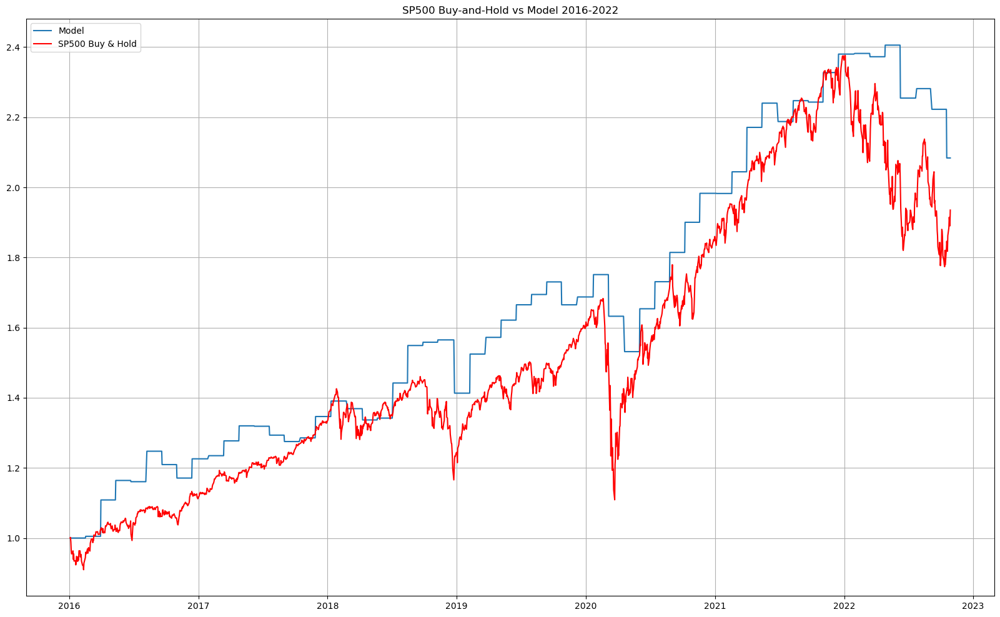

In [64]:
plot_returns(sp500, test_preds, 'SP500 Buy-and-Hold vs Model 2016-2022')

In [67]:
sp500_weekly = sp500.loc[sp500.index < '2021-01-01', :]
sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-period+1)
sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)
sp500_weekly_return = []
for i in range(len(sp500_weekly)):
    if i%period == 0:
        sp500_weekly_return.append(sp500_weekly.iloc[i]['Target'])
    else:
        sp500_weekly_return.append(0)
temp_df = pd.DataFrame({'return': sp500_weekly_return}).shift(period)
temp_df =  temp_df.loc[temp_df['return'] != 0, 'return'].dropna()
sp500_sharpe = temp_df.mean()/temp_df.std()
sp500_sharpe

C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\1427024066.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-period+1)
C:\Users\kmlee\AppData\Local\Temp\ipykernel_6284\1427024066.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)


0.37622827412190246

In [69]:
strategy_weekly_return = test_preds.loc[(test_preds['avg return'] != 1) & (test_preds.index < '2021-01-01'), 'avg return'] - 1
strategy_sharpe = strategy_weekly_return.mean()/strategy_weekly_return.std()
strategy_sharpe

0.4127922398031235

In [68]:
sp500_weekly = sp500
sp500_weekly['Close shifted'] = sp500_weekly.Close.shift(-period+1)
sp500_weekly['Target'] = ((sp500_weekly['Close shifted']-sp500_weekly.Open)/sp500_weekly.Open).shift(-1)
sp500_weekly_return = []
for i in range(len(sp500_weekly)):
    if i%period == 0:
        sp500_weekly_return.append(sp500_weekly.iloc[i]['Target'])
    else:
        sp500_weekly_return.append(0)
temp_df = pd.DataFrame({'return': sp500_weekly_return}).shift(period)
temp_df =  temp_df.loc[temp_df['return'] != 0, 'return'].dropna()
sp500_sharpe = temp_df.mean()/temp_df.std()
sp500_sharpe

0.3023300574480291

In [70]:
strategy_weekly_return = test_preds.loc[test_preds['avg return'] != 1, 'avg return'] - 1
strategy_sharpe = strategy_weekly_return.mean()/strategy_weekly_return.std()
strategy_sharpe

0.336816409396715